# Garbage Classification 
#### CHAPTER 07: _Visualizing Convolutional Neural Networks_
##### From **Interpretable Machine Learning with Python 2nd Edition** by Serg Masís, published by Packt

## The Preparations

### Installing the Libraries

The following cell checks if the libraries required by this chapter are installed and installs them **ONLY** if they aren't. Please note that this step is not necessary if you have already installed ALL libraries required by the entire book with the [setup.py](../setup.py) script for the entire book. Instructions to do this are in the [README.md](../README.md).

In [ ]:
!python chapter_setup.py

### Loading the Libraries

In [ ]:
import math
import os, gc
import random
import machine_learning_datasets as mldatasets
import numpy as np
import pandas as pd
from sklearn.preprocessing import OneHotEncoder

import torchvision
import torch
import pytorch_lightning as pl
import efficientnet_pytorch
from torchinfo import summary

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable 
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import cv2
from tqdm.notebook import tqdm
from captum import attr

pip install 'aif360[LawSchoolGPA]'
pip install 'aif360[Reductions]'
pip install 'aif360[Reductions]'
pip install 'aif360[Reductions]'


### Understanding and Preparing the Data

In [ ]:
%%time
dataset_file = "garbage_dataset_sample"
dataset_url = f"https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/datasets/{dataset_file}.zip"
torchvision.datasets.utils.download_url(dataset_url, ".")
torchvision.datasets.utils.extract_archive(f"{dataset_file}.zip", remove_finished=True)

100%|██████████| 42160874/42160874 [00:00<00:00, 188659371.24it/s]


CPU times: user 701 ms, sys: 296 ms, total: 997 ms
Wall time: 2.19 s


''

In [ ]:
norm_mean = (0.485, 0.456, 0.406)
norm_std  = (0.229, 0.224, 0.225)
transform = torchvision.transforms.Compose(
    [
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(norm_mean, norm_std),
    ]
)

train_data = torchvision.datasets.ImageFolder(f"{dataset_file}/train", transform)
val_data = torchvision.datasets.ImageFolder(f"{dataset_file}/validation", transform)
test_data = torchvision.datasets.ImageFolder(f"{dataset_file}/test", transform)
test_400_data = torchvision.datasets.ImageFolder(f"{dataset_file}/test_400", transform)

In [ ]:
print(f"# Training Samples:    \t{len(train_data)}")
print(f"# Validation Samples:  \t{len(val_data)}")
print(f"# Test Samples:        \t{len(test_data)}")
print(f"Sample Dimension:      \t{test_data[0][0].shape}")
print("="*50)
print(f"# Test 400 Samples:    \t{len(test_400_data)}")
print(f"# 400 Sample Dimension:\t{test_400_data[0][0].shape}")

# Training Samples:    	3724
# Validation Samples:  	931
# Test Samples:        	120
Sample Dimension:      	torch.Size([3, 224, 224])
# Test 400 Samples:    	120
# 400 Sample Dimension:	torch.Size([3, 400, 400])


#### Data Preparation

In [ ]:
labels_l = ['battery', 'biological', 'brown-glass', 'cardboard', 'clothes', 'green-glass',\
            'metal', 'paper', 'plastic', 'shoes', 'trash', 'white-glass']

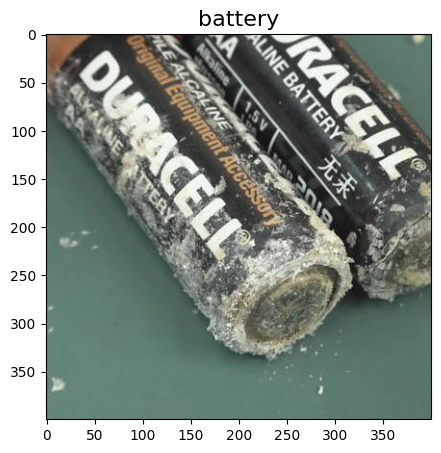

In [ ]:
tensor, label = test_400_data[0]
img = mldatasets.tensor_to_img(tensor, norm_std, norm_mean)
plt.figure(figsize=(5,5))
plt.title(labels_l[label], fontsize=16)
plt.imshow(img)
plt.show()

In [ ]:
y_test = np.array([l for _, l in test_data])
y_val = np.array([l for _, l in val_data])

ohe = OneHotEncoder(sparse=False).\
              fit(np.array(y_test).reshape(-1, 1))

/usr/local/lib/python3.9/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


In [ ]:
rand = 42
os.environ['PYTHONHASHSEED']=str(rand)
np.random.seed(rand)
random.seed(rand)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if device == 'cuda':
    torch.cuda.manual_seed(rand)
else:
    torch.manual_seed(rand)

#### Inspect Data

<ipython-input-13-b56ee8529135>:3: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 4, c+1)


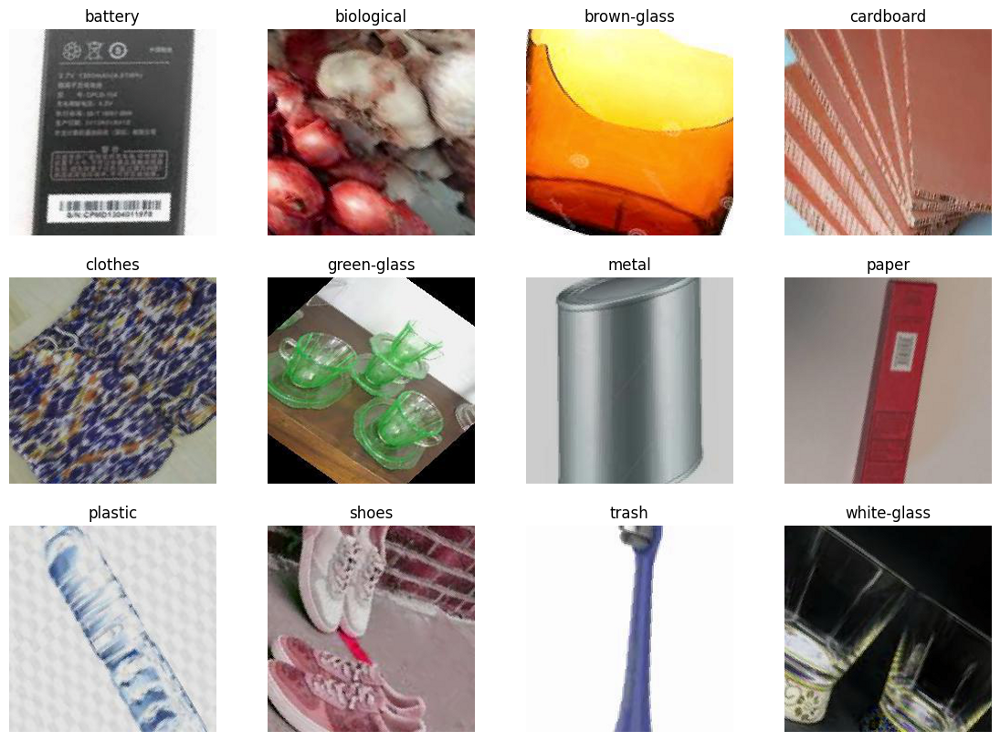

In [ ]:
plt.subplots(figsize=(14,10))
for c, category in enumerate(labels_l):
    plt.subplot(3, 4, c+1)
    plt.title(labels_l[c], fontsize=12)
    idx = np.random.choice(np.where(y_val==c)[0], 1)[0]
    im = mldatasets.tensor_to_img(val_data[idx][0], norm_std, norm_mean)
    plt.imshow(im, interpolation='spline16')
    plt.axis("off")
plt.show()

<ipython-input-14-46adb2cae435>:3: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 4, c+1)


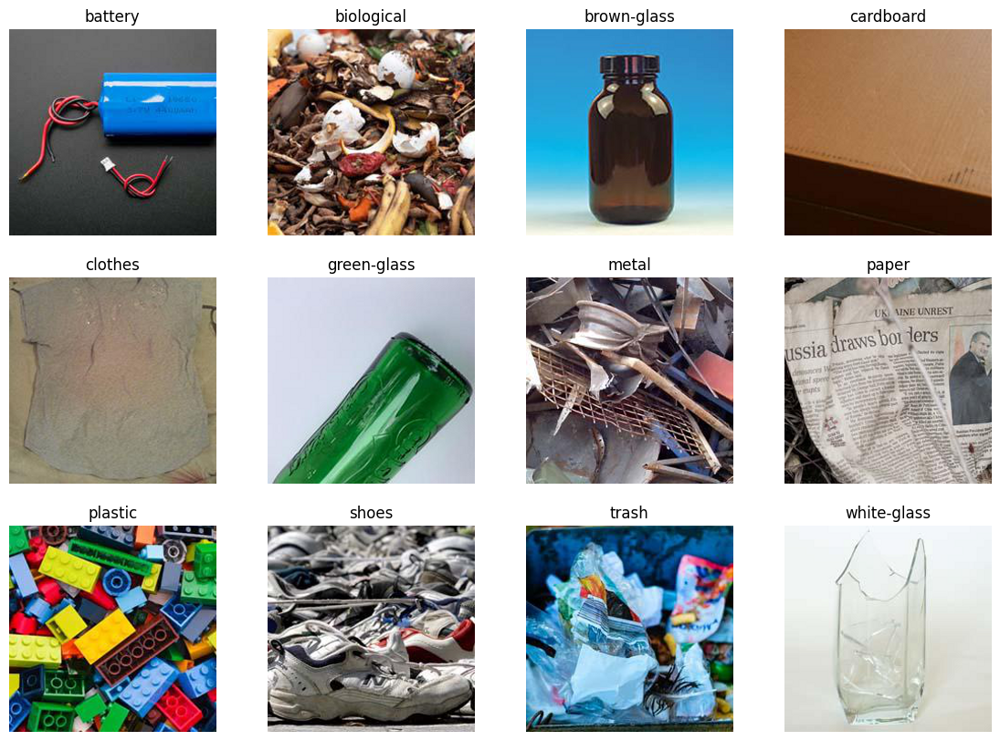

In [ ]:
plt.subplots(figsize=(14,10))
for c, category in enumerate(labels_l):
    plt.subplot(3, 4, c+1)
    plt.title(labels_l[c], fontsize=12)
    idx = np.random.choice(np.where(y_test==c)[0], 1)[0]
    im = mldatasets.tensor_to_img(test_data[idx][0], norm_std, norm_mean)
    plt.imshow(im, interpolation='spline16')
    plt.axis("off")
plt.show()

#### Loading the CNN Model

In [ ]:
def print_gpu_mem_used():
    if torch.cuda.is_available():
        mem_info = torch.cuda.mem_get_info()
        mem_info_pct = 1 - (mem_info[0]/mem_info[1])
        print(f"GPU Mem Used:\t{mem_info_pct:.2%}")

def clear_gpu_cache():
    gc.collect()
    if torch.cuda.is_available():
        torch.cuda.empty_cache()

In [ ]:
#if you are using a GPU
# print(torch.cuda.memory_summary())

|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |      0 B   |      0 B   |      0 B   |      0 B   |
|       from large pool |      0 B   |      0 B   |      0 B   |      0 B   |
|       from small pool |      0 B   |      0 B   |      0 B   |      0 B   |
|---------------------------------------------------------------------------|
| Active memory         |      0 B   |      0 B   |      0 B   |      0 B   |
|       from large pool |      0 B   |      0 B   |      0 B   |

In [ ]:
class EfficientLite(pl.LightningModule):
    def __init__(self, lr: float, num_class: int, pretrained="efficientnet-b0", *args, **kwargs):
        super().__init__()

        self.save_hyperparameters()
        self.model = efficientnet_pytorch.EfficientNet.from_pretrained(pretrained)
        in_features = self.model._fc.in_features
        self.model._fc = torch.nn.Linear(in_features, num_class)

    def forward(self, x):
        return self.model(x)

    def predict(self, dataset):
        self.model.eval()
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        with torch.no_grad():
            if isinstance(dataset, np.ndarray):
                if len(dataset.shape) == 3:
                    dataset = np.expand_dims(dataset, axis=0)
                dataset = [(x,0) for x in dataset]
            loader = torch.utils.data.DataLoader(dataset, batch_size = 32)
            probs = None
        for X_batch, _ in tqdm(loader):
            X_batch = X_batch.to(device, dtype=torch.float32)
            logits_batch =  self.model(X_batch)
            probs_batch = torch.nn.functional.softmax(logits_batch, dim=1).cpu().detach().numpy()
            if probs is not None: 
                probs = np.concatenate((probs, probs_batch))
            else:
                probs = probs_batch
            clear_gpu_cache()
        return probs

In [ ]:
%%time
model_weights_file = "garbage-finetuned-efficientnet-b4"
model_url = f"https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python-2E/raw/main/models/{model_weights_file}.ckpt"
torchvision.datasets.utils.download_url(model_url, ".")
garbage_mdl = EfficientLite.load_from_checkpoint(f"{model_weights_file}.ckpt",\
                                                 map_location=torch.device(device))
garbage_mdl = garbage_mdl.to(device).eval()
print(summary(garbage_mdl))

100%|██████████| 211949168/211949168 [00:01<00:00, 136893327.14it/s]
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.8.6 to v2.0.2. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint --file garbage-finetuned-efficientnet-b4.ckpt`
Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b4-6ed6700e.pth" to /root/.cache/torch/hub/checkpoints/efficientnet-b4-6ed6700e.pth
100%|██████████| 74.4M/74.4M [00:00<00:00, 78.5MB/s]


Loaded pretrained weights for efficientnet-b4
Layer (type:depth-idx)                                  Param #
EfficientLite                                           --
├─EfficientNet: 1-1                                     --
│    └─Conv2dStaticSamePadding: 2-1                     1,296
│    │    └─ZeroPad2d: 3-1                              --
│    └─BatchNorm2d: 2-2                                 96
│    └─ModuleList: 2-3                                  --
│    │    └─MBConvBlock: 3-2                            2,940
│    │    └─MBConvBlock: 3-3                            1,206
│    │    └─MBConvBlock: 3-4                            11,878
│    │    └─MBConvBlock: 3-5                            18,120
│    │    └─MBConvBlock: 3-6                            18,120
│    │    └─MBConvBlock: 3-7                            18,120
│    │    └─MBConvBlock: 3-8                            25,848
│    │    └─MBConvBlock: 3-9                            57,246
│    │    └─MBConvBlock: 3-10  

In [ ]:
print(summary(garbage_mdl, input_size=(64, 3, 224, 224)))

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientLite                                           [64, 12]                  --
├─EfficientNet: 1-1                                     [64, 12]                  --
│    └─Conv2dStaticSamePadding: 2-1                     [64, 48, 112, 112]        1,296
│    │    └─ZeroPad2d: 3-1                              [64, 3, 225, 225]         --
│    └─BatchNorm2d: 2-2                                 [64, 48, 112, 112]        96
│    └─MemoryEfficientSwish: 2-3                        [64, 48, 112, 112]        --
│    └─ModuleList: 2-4                                  --                        --
│    │    └─MBConvBlock: 3-2                            [64, 24, 112, 112]        2,940
│    │    └─MBConvBlock: 3-3                            [64, 24, 112, 112]        1,206
│    │    └─MBConvBlock: 3-4                            [64, 32, 56, 56]          11,878
│    │    └─MBConvBlock: 3-5                   

/usr/local/lib/python3.9/dist-packages/torchinfo/torchinfo.py:477: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  action_fn=lambda data: sys.getsizeof(data.storage()),
/usr/local/lib/python3.9/dist-packages/torch/storage.py:665: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return super().__sizeof__() + self.nbytes()


## Assessing the CNN Classifier with Traditional Interpretation Methods

  0%|          | 0/30 [00:00<?, ?it/s]

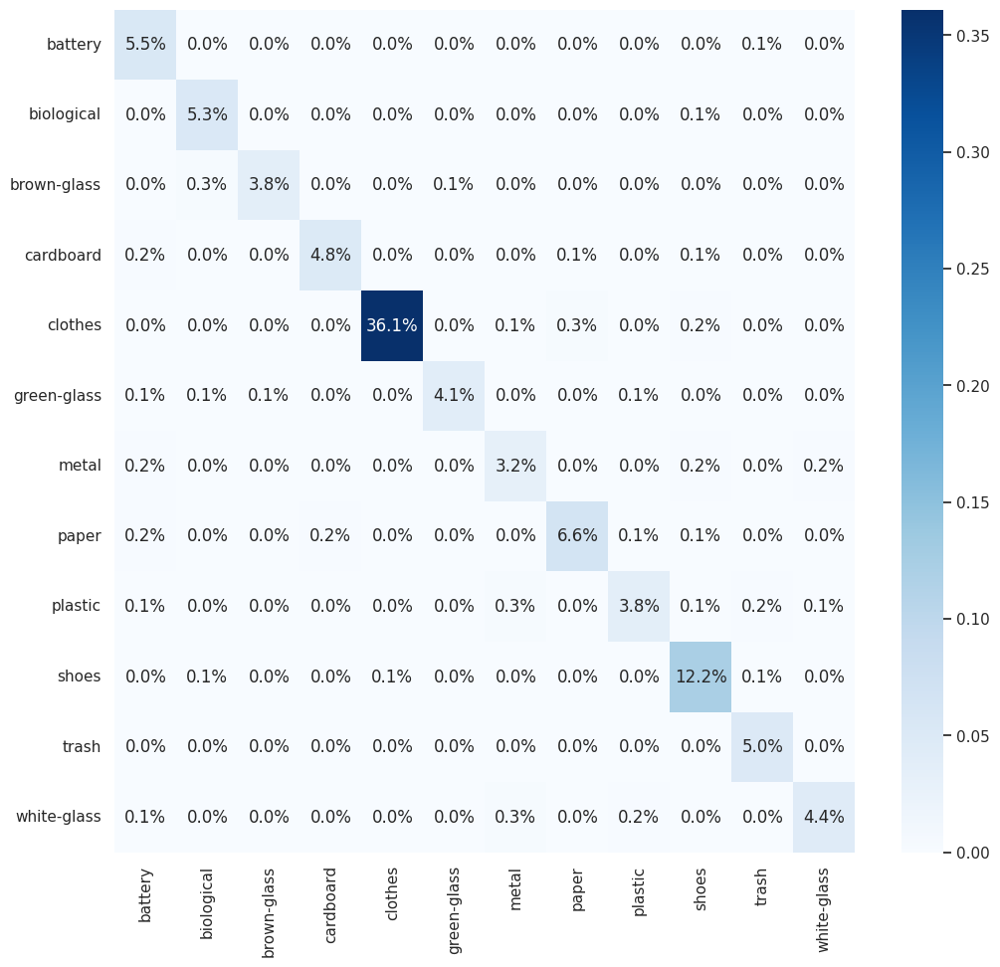

              precision    recall  f1-score   support

     battery      0.850     0.981     0.911        52
  biological      0.907     0.980     0.942        50
 brown-glass      0.972     0.897     0.933        39
   cardboard      0.957     0.918     0.938        49
     clothes      0.997     0.982     0.990       342
 green-glass      0.974     0.905     0.938        42
       metal      0.811     0.833     0.822        36
       paper      0.938     0.910     0.924        67
     plastic      0.897     0.814     0.854        43
       shoes      0.934     0.974     0.954       117
       trash      0.922     1.000     0.959        47
 white-glass      0.932     0.872     0.901        47

    accuracy                          0.947       931
   macro avg      0.924     0.922     0.922       931
weighted avg      0.949     0.947     0.947       931



In [ ]:
orig_plt_params = plt.rcParams
sns.set()
y_val_pred, y_val_prob =\
            mldatasets.evaluate_multiclass_mdl(garbage_mdl, val_data, class_l=labels_l,\
                                    ohe=ohe, plot_roc=False)

  0%|          | 0/4 [00:00<?, ?it/s]

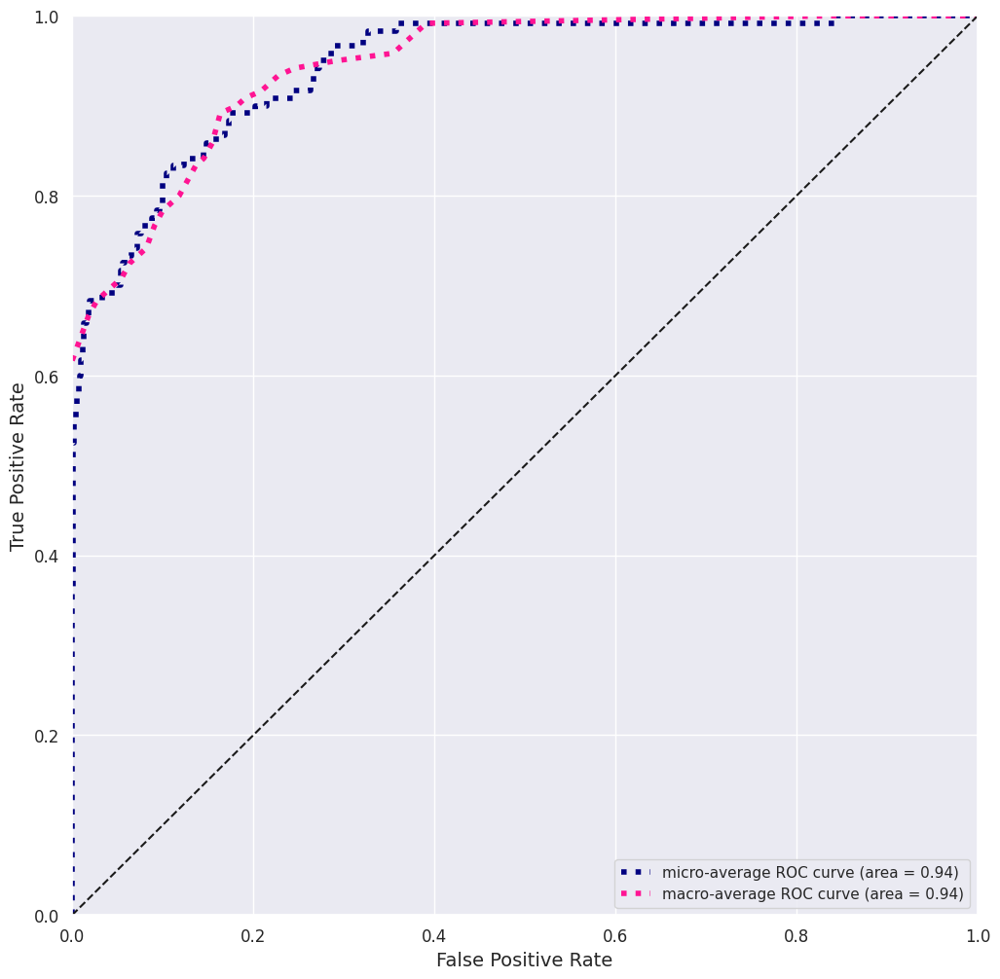

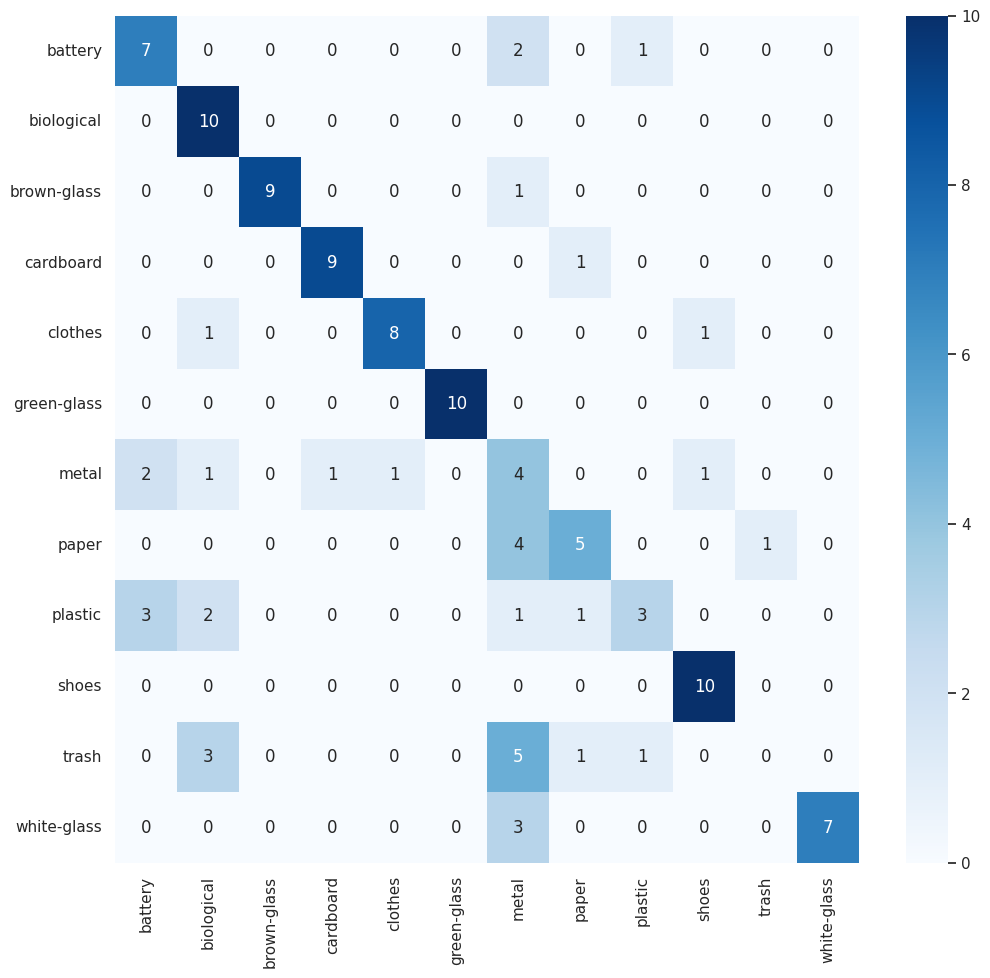

              precision    recall  f1-score   support

     battery      0.583     0.700     0.636        10
  biological      0.588     1.000     0.741        10
 brown-glass      1.000     0.900     0.947        10
   cardboard      0.900     0.900     0.900        10
     clothes      0.889     0.800     0.842        10
 green-glass      1.000     1.000     1.000        10
       metal      0.200     0.400     0.267        10
       paper      0.625     0.500     0.556        10
     plastic      0.600     0.300     0.400        10
       shoes      0.833     1.000     0.909        10
       trash      0.000     0.000     0.000        10
 white-glass      1.000     0.700     0.824        10

    accuracy                          0.683       120
   macro avg      0.685     0.683     0.668       120
weighted avg      0.685     0.683     0.668       120



In [ ]:
y_test_pred, y_test_prob =\
            mldatasets.evaluate_multiclass_mdl(garbage_mdl, test_data,\
                            class_l=labels_l, ohe=ohe, plot_roc=True,\
                            plot_roc_class=False, pct_matrix=False)

### Determining what Misclassifications to Focus On

In [ ]:
preds_df = pd.DataFrame({'y_true':[labels_l[o] for o in y_test], 'y_pred':y_test_pred})

probs_df = pd.DataFrame(y_test_prob*100).round(1)
probs_df.loc['Total']= probs_df.sum().round(1)
probs_df.columns = labels_l
probs_df = probs_df.sort_values('Total', axis=1, ascending=False)
probs_df.drop(['Total'], axis=0, inplace=True)
probs_final_df = probs_df.iloc[:,0:12]

preds_probs_df = pd.concat([preds_df, probs_final_df], axis=1)
num_cols_l = list(preds_probs_df.columns[2:])
num_fmt_dict = dict(zip(num_cols_l, ["{:,.1f}%"]*len(num_cols_l)))
preds_probs_df[(preds_probs_df.y_true!=preds_probs_df.y_pred) |\
              (preds_probs_df.y_true.isin(['battery','white-glass']))].style.\
    format(num_fmt_dict).\
    apply(lambda x: ['background: lightgreen' if (x[0] == x[1])\
                    else '' for i in x], axis=1).\
    apply(lambda x: ['background: orange' if (x[0] != x[1] and\
                    x[1] == 'metal' and x[0] == 'battery')\
                    else '' for i in x], axis=1).\
    apply(lambda x: ['background: yellow' if (x[0] != x[1] and x[0] == 'plastic')\
                    else '' for i in x], axis=1).\
    apply(lambda x: ['font-weight: bold' if isinstance(i, float) and i >= 50\
                    else '' for i in x], axis=1).\
    apply(lambda x: ['color:transparent' if i == 0.0\
                    else '' for i in x], axis=1)

,y_true,y_pred,biological,metal,shoes,battery,paper,cardboard,brown-glass,green-glass,clothes,white-glass,plastic,trash
0,battery,battery,0.0%,0.1%,0.0%,99.7%,0.1%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
1,battery,battery,0.1%,1.5%,0.3%,96.7%,0.3%,0.1%,0.3%,0.1%,0.0%,0.0%,0.5%,0.0%
2,battery,battery,0.0%,0.1%,0.0%,99.6%,0.2%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%,0.0%
3,battery,battery,0.3%,0.4%,0.1%,97.4%,1.0%,0.3%,0.1%,0.1%,0.0%,0.0%,0.1%,0.2%
4,battery,battery,1.0%,5.6%,0.6%,58.8%,1.2%,0.7%,2.1%,6.8%,0.1%,1.9%,17.0%,4.2%
5,battery,battery,0.3%,1.0%,0.5%,94.7%,0.5%,1.1%,0.5%,0.1%,0.0%,0.2%,0.2%,0.9%
6,battery,battery,0.0%,0.4%,0.0%,99.0%,0.3%,0.0%,0.1%,0.0%,0.0%,0.0%,0.0%,0.0%
7,battery,metal,0.4%,82.4%,2.1%,1.1%,1.5%,0.9%,4.6%,0.4%,1.1%,3.6%,1.2%,0.7%
8,battery,metal,0.0%,92.6%,0.1%,1.6%,0.6%,0.1%,0.2%,0.0%,0.0%,0.3%,4.4%,0.0%
9,battery,plastic,0.5%,0.5%,0.2%,1.4%,0.6%,0.4%,0.6%,1.0%,0.4%,2.7%,84.6%,6.9%


In [ ]:
plastic_FN_idxs = preds_df[(preds_df['y_true'] != preds_df['y_pred']) &\
                           (preds_df['y_true'] == 'plastic')].index.to_list()
metal_FP_idxs = preds_df[(preds_df['y_true'] != preds_df['y_pred']) &\
                              (preds_df['y_pred'] == 'metal') &\
                              (preds_df['y_true'] == 'battery')].index.to_list()
battery_TP_idxs = preds_df[(preds_df['y_true'] == preds_df['y_pred']) &\
                           (preds_df['y_true'] == 'battery')].index.to_list()
wglass_TP_idxs = preds_df[(preds_df['y_true'] == preds_df['y_pred']) &\
                           (preds_df['y_true'] == 'white-glass')].index.to_list()

## Visualizing the Learning Process with Activation-Based Methods

### Intermediate Activations

In [ ]:
conv_layers = []

model_children = list(garbage_mdl.model.children())
for model_child in model_children:
    if (type(model_child) == efficientnet_pytorch.utils.Conv2dStaticSamePadding):
        conv_layers.append(model_child)
    elif (type(model_child) == torch.nn.modules.container.ModuleList):
        module_children = list(model_child.children())
        module_convs = []
        for module_child in module_children:
            module_convs.append(list(module_child.children())[0])
        conv_layers.extend(module_convs[:6])

print(conv_layers)

[Conv2dStaticSamePadding(
  3, 48, kernel_size=(3, 3), stride=(2, 2), bias=False
  (static_padding): ZeroPad2d((0, 1, 0, 1))
), Conv2dStaticSamePadding(
  48, 48, kernel_size=(3, 3), stride=[1, 1], groups=48, bias=False
  (static_padding): ZeroPad2d((1, 1, 1, 1))
), Conv2dStaticSamePadding(
  24, 24, kernel_size=(3, 3), stride=(1, 1), groups=24, bias=False
  (static_padding): ZeroPad2d((1, 1, 1, 1))
), Conv2dStaticSamePadding(
  24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False
  (static_padding): Identity()
), Conv2dStaticSamePadding(
  32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False
  (static_padding): Identity()
), Conv2dStaticSamePadding(
  32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False
  (static_padding): Identity()
), Conv2dStaticSamePadding(
  32, 192, kernel_size=(1, 1), stride=(1, 1), bias=False
  (static_padding): Identity()
), Conv2dStaticSamePadding(
  448, 1792, kernel_size=(1, 1), stride=(1, 1), bias=False
  (static_padding): Identity()
)]


In [ ]:
idx = battery_TP_idxs[0]
layer = 0
tensor = test_data[idx][0][None, :].to(device)
label = y_test[idx]
method = attr.LayerActivation(garbage_mdl, conv_layers[layer])
attribution = method.attribute(tensor).detach().cpu().numpy()
print(attribution.shape)

(1, 48, 112, 112)


In [ ]:
cbinary_cmap = LinearSegmentedColormap.from_list('custom binary', 
                                                 [(0, '#ffffff'),
                                                  (0.25, '#777777'),
                                                  (1, '#000000')])

<ipython-input-27-5c58d6a59194>:10: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(ScalarMappable(norm='linear', cmap=cbinary_cmap), orientation="vertical")


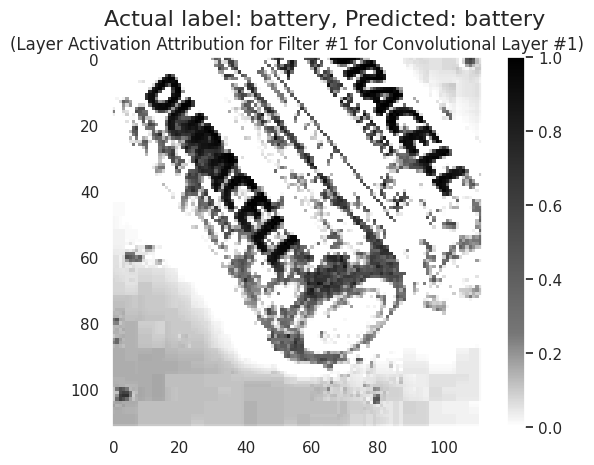

In [ ]:
filter = 0
filter_attr = attribution[0,filter]
filter_attr = mldatasets.apply_cmap(filter_attr, cbinary_cmap, 'positive')
y_true = labels_l[label]
y_pred = y_test_pred[idx]
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
fig.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
ax.set_title(f"({method.get_name()} Attribution for Filter #{filter+1} for Convolutional Layer #{layer+1})", fontsize=12)
ax.imshow(filter_attr)
ax.grid(False)
fig.colorbar(ScalarMappable(norm='linear', cmap=cbinary_cmap), ax=ax, orientation="vertical")
plt.show()

In [ ]:
#only performs garbage collection, if device=CPU
print_gpu_mem_used()
clear_gpu_cache()
print_gpu_mem_used()

GPU Mem Used:	5.05%
GPU Mem Used:	5.00%


In [ ]:
%%time
for l, layer in enumerate(conv_layers):
    layer = conv_layers[l]
    method = attr.LayerActivation(garbage_mdl, layer)
    for idx in battery_TP_idxs:
        orig_img = mldatasets.tensor_to_img(test_400_data[idx][0],\
                                            norm_std, norm_mean, to_numpy=True)
        tensor = test_data[idx][0][None, :].to(device)
        label = int(y_test[idx])
        attribution = method.attribute(tensor).detach().cpu().numpy()
        viz_img =  mldatasets.create_attribution_grid(attribution, cmap='copper',\
                                                      cmap_norm='positive')
        y_true = labels_l[label]
        y_pred = y_test_pred[idx]
        probs_s = probs_df.loc[idx]
        title = f'CNN Layer #{l+1} {method.get_name()} Attributions for Sample #{idx}'
        mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                        y_pred, probs_s, title=title)
    clear_gpu_cache()

## Evaluating Misclassifications with Gradient-Based Attribution Methods

In [ ]:
misclass_idxs = metal_FP_idxs + plastic_FN_idxs[-4:]
misclass_data = torch.utils.data.Subset(test_data, misclass_idxs)
misclass_loader = torch.utils.data.DataLoader(misclass_data, batch_size = 32)
X_misclass, y_misclass = next(iter(misclass_loader))
X_misclass, y_misclass = X_misclass.to(device), y_misclass.to(device)

In [ ]:
def get_attribution_maps(method, model, device, X, y=None, init_args={},\
                         nt_type=None, nt_samples=10, stdevs=0.2, **kwargs):
    attr_maps_size = tuple([0] + list(X.shape[1:]))
    attr_maps = torch.empty(attr_maps_size).to(device)

    attr_method = method(model, **init_args)
    if nt_type is not None:
        noise_tunnel = attr.NoiseTunnel(attr_method)
        nt_attr_maps = torch.empty(attr_maps_size).to(device)

    for i in tqdm(range(len(X))):
        X_i = X[i].unsqueeze(0).requires_grad_()
        model.zero_grad()
        extra_args = {**kwargs}
        if y is not None:
            y_i = y[i].squeeze_()
            extra_args.update({"target":y_i})

        attr_map = attr_method.attribute(X_i, **extra_args)
        attr_maps = torch.cat([attr_maps, attr_map])

        if nt_type is not None:
            model.zero_grad()
            nt_attr_map = noise_tunnel.attribute(X_i, nt_type=nt_type,\
                                nt_samples=nt_samples, stdevs=stdevs,\
                                nt_samples_batch_size=1, **extra_args)
            nt_attr_maps = torch.cat([nt_attr_maps, nt_attr_map])
        clear_gpu_cache()
        
    if nt_type is not None:
        return attr_maps, nt_attr_maps

    return attr_maps

### Saliency Maps

In [ ]:
saliency_maps = get_attribution_maps(attr.Saliency, garbage_mdl,\
                                     device, X_misclass, y_misclass)

  0%|          | 0/6 [00:00<?, ?it/s]

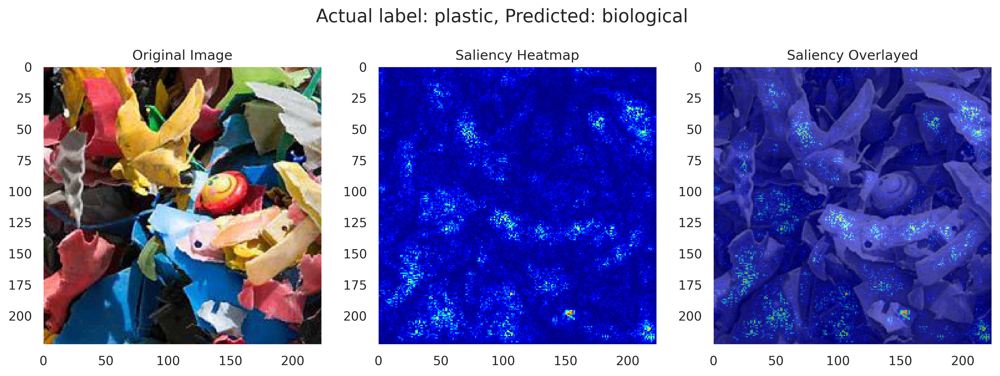

In [ ]:
pos = 4
orig_img = mldatasets.tensor_to_img(X_misclass[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(saliency_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Saliency Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Saliency Overlayed")

idx = misclass_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()


### Grad-CAM

In [ ]:
%%time
gradcam_maps = get_attribution_maps(attr.GuidedGradCam, garbage_mdl,\
                                    device, X_misclass, y_misclass, init_args={'layer':conv_layers[3]},\
                                    interpolate_mode='bilinear')

  0%|          | 0/6 [00:00<?, ?it/s]

CPU times: user 2.47 s, sys: 70.1 ms, total: 2.54 s
Wall time: 2.52 s


/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


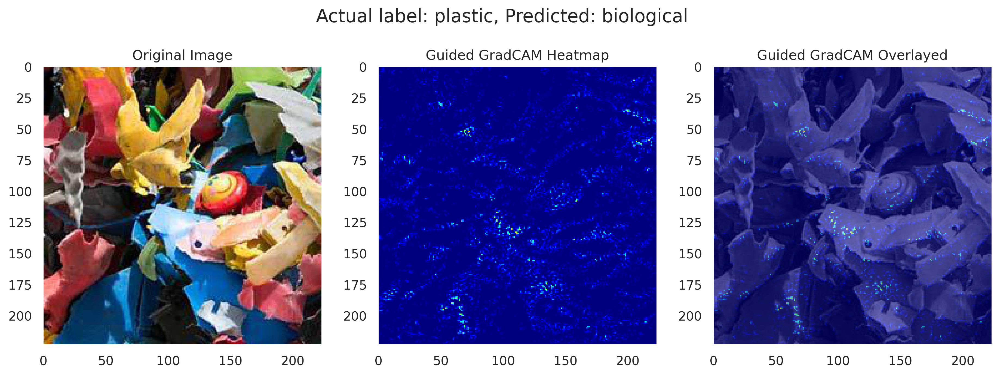

In [ ]:
pos = 4
orig_img = mldatasets.tensor_to_img(X_misclass[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(gradcam_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Guided GradCAM Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Guided GradCAM Overlayed")

idx = misclass_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### Integrated Gradients

In [ ]:
%%time
ig_maps, smooth_ig_maps = get_attribution_maps(attr.IntegratedGradients, garbage_mdl,\
                                  device, X_misclass, y_misclass, nt_type='smoothgrad',\
                                  nt_samples=20, stdevs=0.2)

  0%|          | 0/6 [00:00<?, ?it/s]

CPU times: user 19.3 s, sys: 305 ms, total: 19.6 s
Wall time: 19.5 s


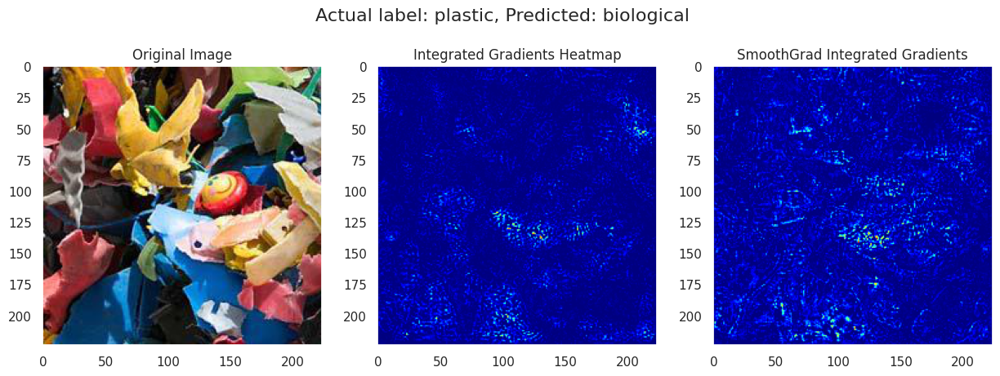

In [ ]:
pos = 4
orig_img = mldatasets.tensor_to_img(X_misclass[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(ig_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Integrated Gradients Heatmap")

nt_attr_map = mldatasets.tensor_to_img(smooth_ig_maps[pos],\
                                       to_numpy=True, cmap_norm='positive')

axs[2].imshow(nt_attr_map)
axs[2].grid(None)
axs[2].set_title("SmoothGrad Integrated Gradients")

idx = misclass_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### DeepLift

In [ ]:
deeplift_maps = get_attribution_maps(attr.DeepLift, garbage_mdl,\
                                     device, X_misclass, y_misclass)

  0%|          | 0/6 [00:00<?, ?it/s]

/usr/local/lib/python3.9/dist-packages/captum/attr/_core/deep_lift.py:304: UserWarning: Setting forward, backward hooks and attributes on non-linear
               activations. The hooks and attributes will be removed
            after the attribution is finished
  warnings.warn(


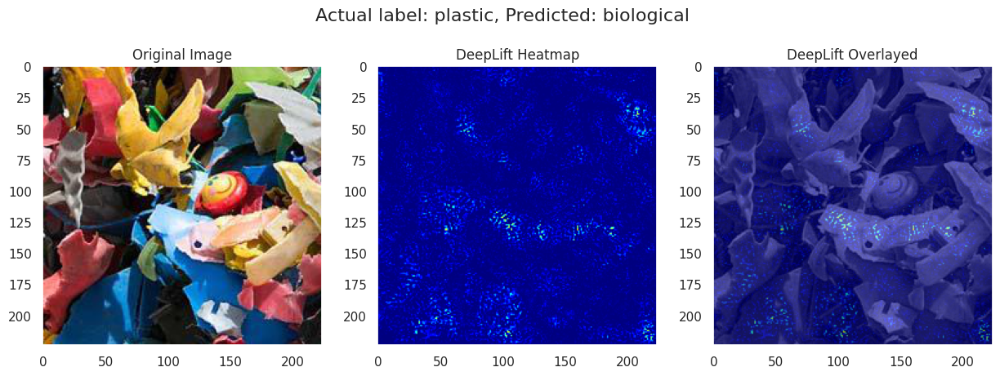

In [ ]:
pos = 4
orig_img = mldatasets.tensor_to_img(X_misclass[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(deeplift_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("DeepLift Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("DeepLift Overlayed")

idx = misclass_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### Tying it all together

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


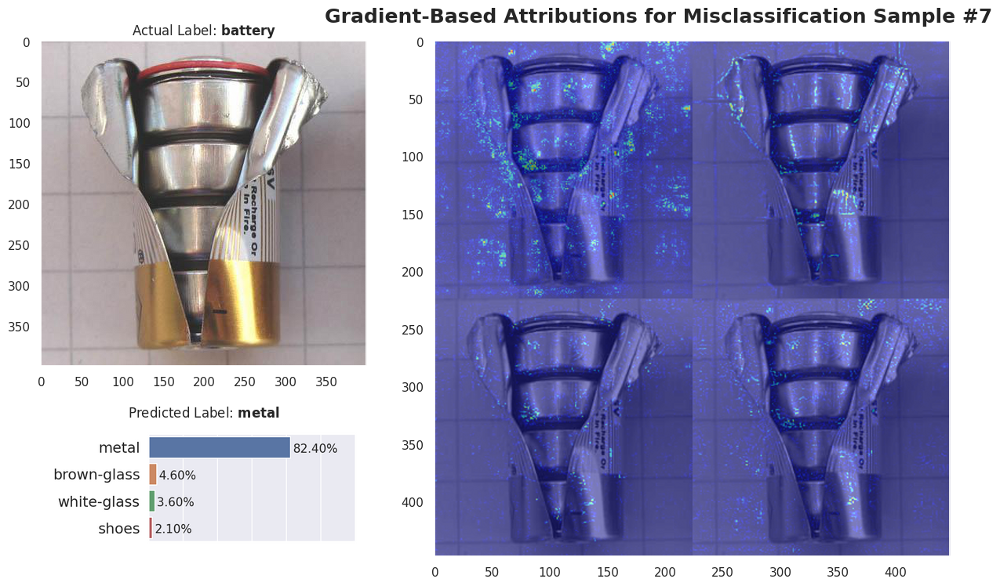

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


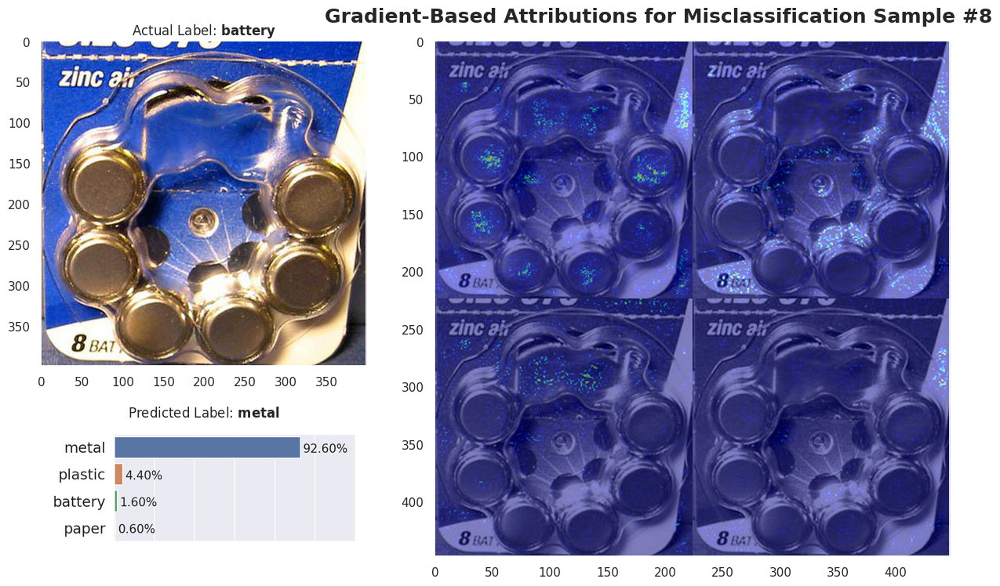

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


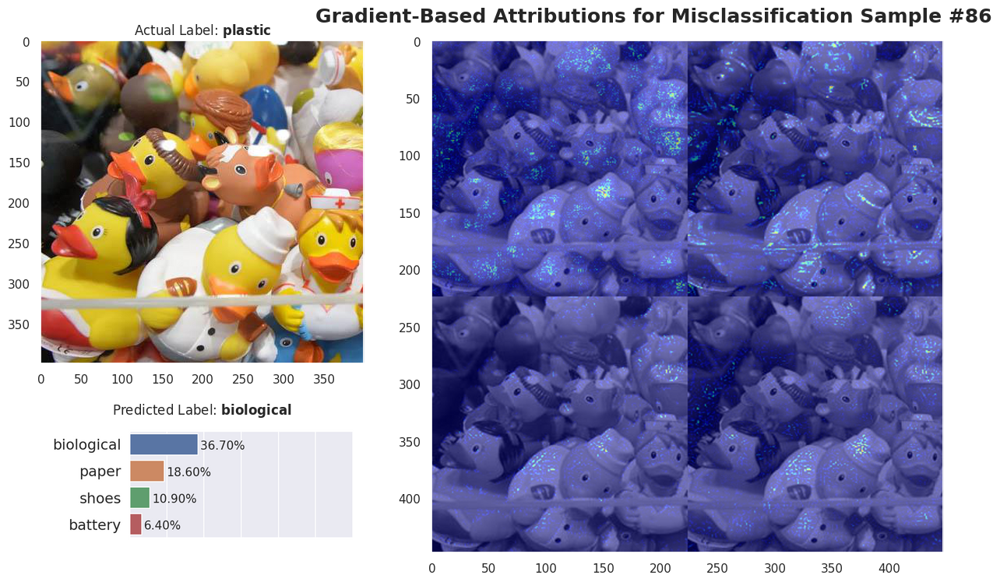

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


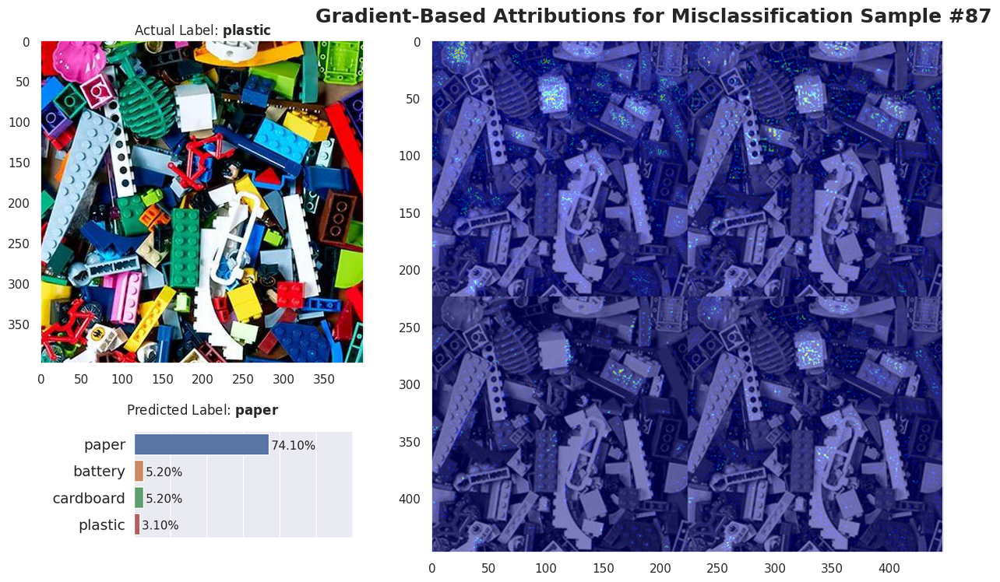

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


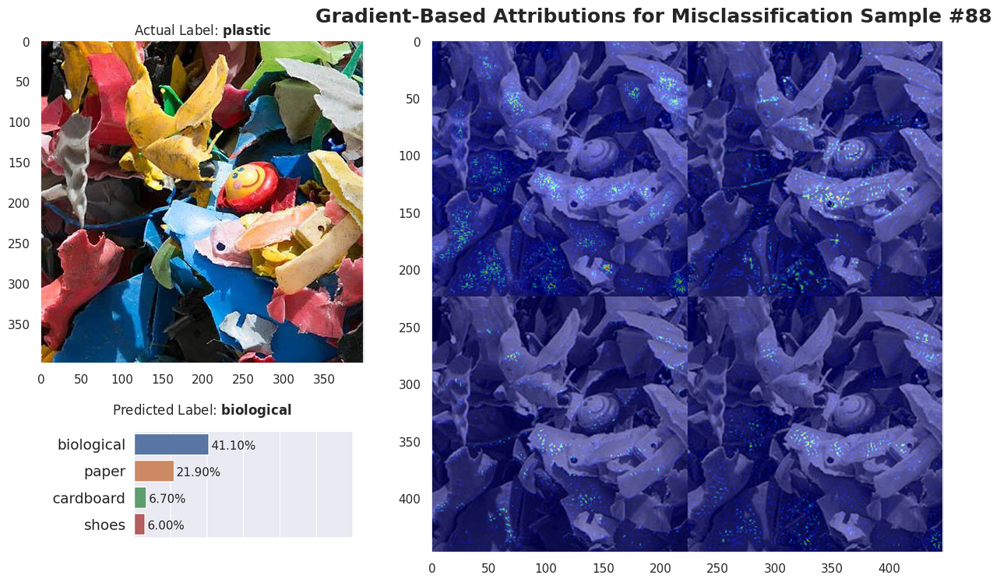

/content/mldatasets/common.py:467: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that heatmap values are allclose to 0.
  warnings.warn(


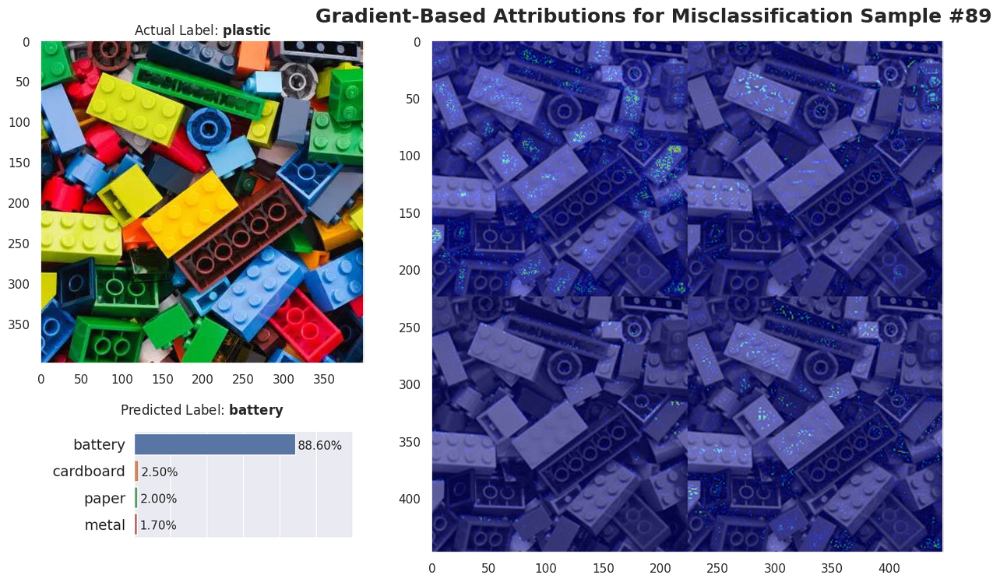

In [ ]:
for pos, idx in enumerate(misclass_idxs):
    orig_img = mldatasets.tensor_to_img(test_400_data[idx][0],\
                                        norm_std, norm_mean, to_numpy=True)
    bg_img = mldatasets.tensor_to_img(test_data[idx][0],\
                                      norm_std, norm_mean, to_numpy=True)
    map1 = mldatasets.tensor_to_img(saliency_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map2 = mldatasets.tensor_to_img(smooth_ig_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map3 = mldatasets.tensor_to_img(gradcam_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map4 = mldatasets.tensor_to_img(deeplift_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    viz_img = cv2.vconcat([
            cv2.hconcat([map1, map2]),
            cv2.hconcat([map3, map4])
        ])
    label = int(y_test[idx])
    y_true = labels_l[label]
    y_pred = y_test_pred[idx]
    probs_s = probs_df.loc[idx]
    title = 'Gradient-Based Attributions for Misclassification Sample #{}'.format(idx)
    mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                    y_pred, probs_s, title=title)

# Understanding classifications with perturbation-based attribution methods

In [ ]:
correctcls_idxs = wglass_TP_idxs[:4] + battery_TP_idxs[:4] 
correctcls_data = torch.utils.data.Subset(test_data, correctcls_idxs)
correctcls_loader = torch.utils.data.DataLoader(correctcls_data, batch_size = 32)
X_correctcls, y_correctcls = next(iter(correctcls_loader))
X_correctcls, y_correctcls = X_correctcls.to(device), y_correctcls.to(device)

In [ ]:
feature_mask = torch.zeros(3, 224, 224).int().to(device)
counter = 0
strides = 16
for row in range(0, 224, strides):
    for col in range(0, 224, strides):
        feature_mask[:, row:row+strides, col:col+strides] = counter
        counter += 1

In [ ]:
baseline_light = float(X_correctcls.max().detach().cpu())
baseline_dark = float(X_correctcls.min().detach().cpu())

### Feature Ablation

In [ ]:
ablation_maps = get_attribution_maps(attr.FeatureAblation, garbage_mdl,\
                                     device, X_correctcls, y_correctcls,\
                                     feature_mask=feature_mask,\
                                     baselines=baseline_dark)

  0%|          | 0/8 [00:00<?, ?it/s]

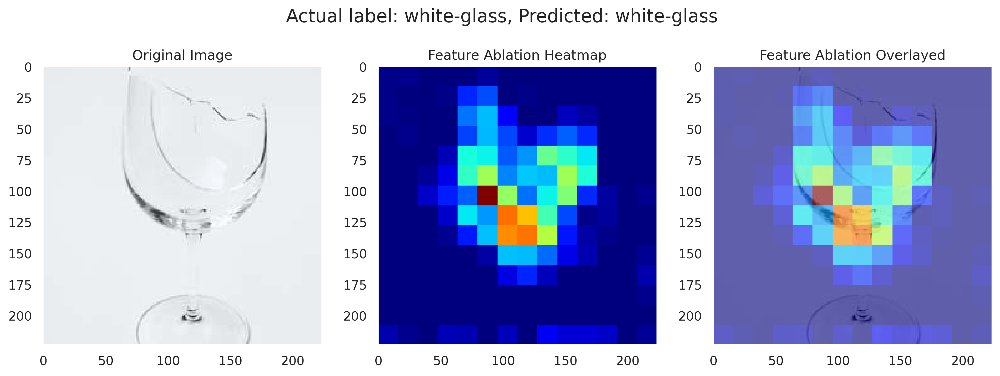

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(ablation_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Feature Ablation Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Feature Ablation Overlayed")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### Occlusion sensitivity

In [ ]:
occlusion_maps = get_attribution_maps(attr.Occlusion, garbage_mdl,\
                                      device, X_correctcls, y_correctcls,\
                                      baselines=baseline_dark,\
                                      sliding_window_shapes=(3,16,16), strides=(3,16,16))

  0%|          | 0/8 [00:00<?, ?it/s]

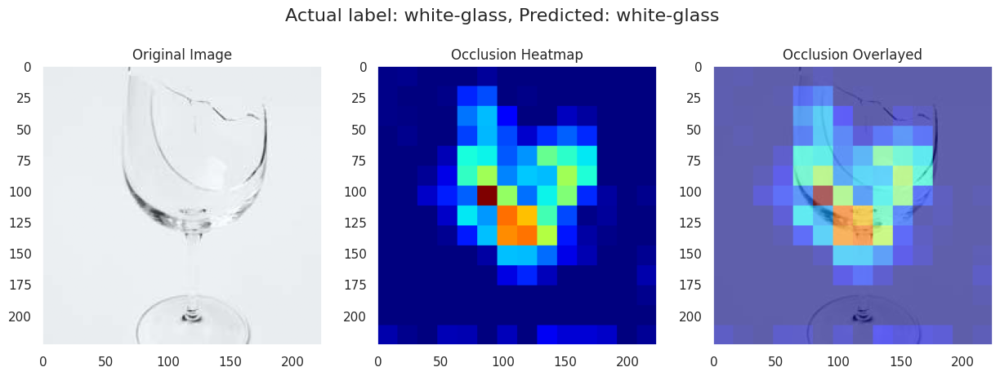

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(occlusion_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Occlusion Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Occlusion Overlayed")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

In [ ]:
occlusion_maps = get_attribution_maps(attr.Occlusion, garbage_mdl,\
                                      device, X_correctcls, y_correctcls,\
                                      baselines=baseline_dark,\
                                      sliding_window_shapes=(3,16,16), strides=(3,8,8))

  0%|          | 0/8 [00:00<?, ?it/s]

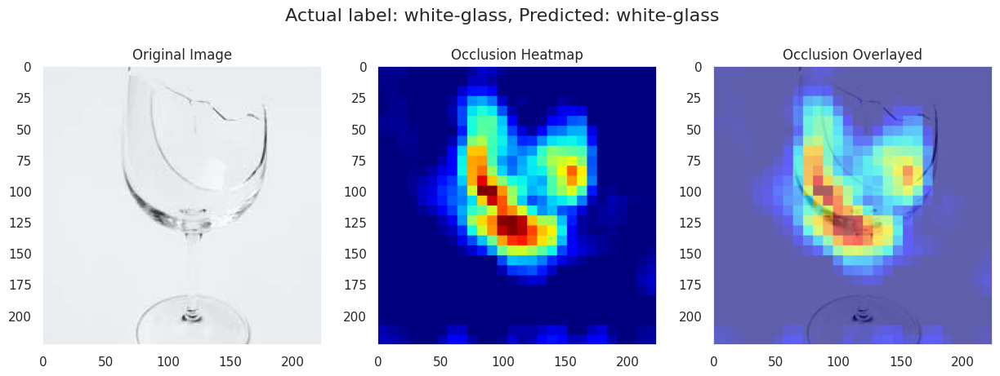

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(occlusion_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Occlusion Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Occlusion Overlayed")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### Shapely Value Sampling

In [ ]:
%%time
svs_maps = get_attribution_maps(attr.ShapleyValueSampling, garbage_mdl,\
                                device, X_correctcls, y_correctcls,\
                                baselines=baseline_dark,\
                                n_samples=5, feature_mask=feature_mask)

  0%|          | 0/8 [00:00<?, ?it/s]

CPU times: user 2min 53s, sys: 289 ms, total: 2min 53s
Wall time: 2min 53s


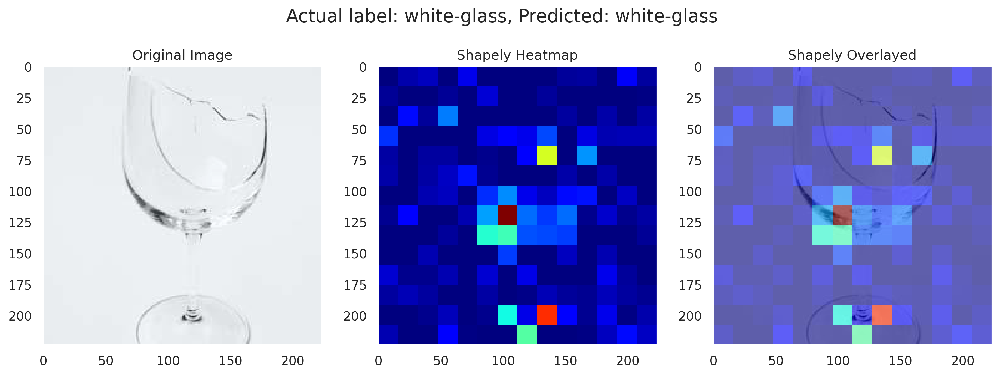

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(svs_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

fig, axs = plt.subplots(1, 3, figsize=(15,5))
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Shapely Heatmap")

axs[2].imshow(np.mean(orig_img, axis=2), cmap="gray")
axs[2].imshow(attr_map, alpha=0.6)
axs[2].grid(None)
axs[2].set_title("Shapely Overlayed")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### KernelSHAP

In [ ]:
%%time
kshap_light_maps = get_attribution_maps(attr.KernelShap, garbage_mdl,\
                                  device, X_correctcls, y_correctcls,\
                                  baselines=baseline_light,\
                                  n_samples=600,\
                                  feature_mask=feature_mask)
kshap_dark_maps = get_attribution_maps(attr.KernelShap, garbage_mdl,\
                                  device, X_correctcls, y_correctcls,\
                                  baselines=baseline_dark,\
                                  n_samples=600,\
                                  feature_mask=feature_mask)

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

CPU times: user 3min 39s, sys: 19.7 s, total: 3min 58s
Wall time: 3min 36s


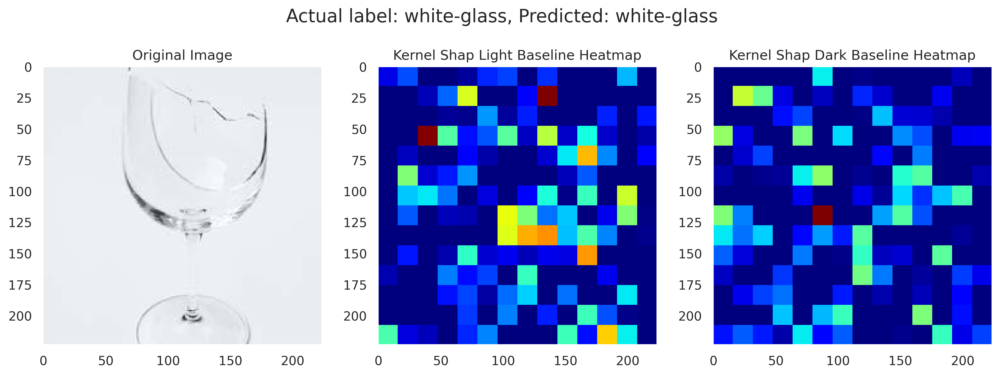

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(kshap_light_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

fig, axs = plt.subplots(1, 3, figsize=(15,5), dpi=300)
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Kernel Shap Light Baseline Heatmap")

attr_dark_map = mldatasets.tensor_to_img(kshap_dark_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

axs[2].imshow(attr_dark_map)
axs[2].grid(None)
axs[2].set_title("Kernel Shap Dark Baseline Heatmap")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

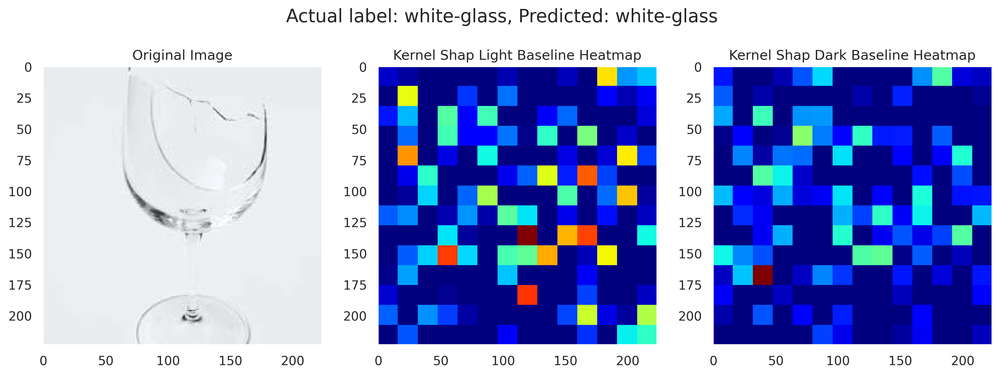

In [ ]:
pos = 2
orig_img = mldatasets.tensor_to_img(X_correctcls[pos], norm_std,\
                         norm_mean, to_numpy=True)
attr_map = mldatasets.tensor_to_img(kshap_light_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

fig, axs = plt.subplots(1, 3, figsize=(15,5), dpi=300)
 
axs[0].imshow(orig_img)
axs[0].grid(None)
axs[0].set_title("Original Image")

axs[1].imshow(attr_map)
axs[1].grid(None)
axs[1].set_title("Kernel Shap Light Baseline Heatmap")

attr_dark_map = mldatasets.tensor_to_img(kshap_dark_maps[pos], to_numpy=True,\
                                    cmap_norm='positive')  

axs[2].imshow(attr_dark_map)
axs[2].grid(None)
axs[2].set_title("Kernel Shap Dark Baseline Heatmap")

idx = correctcls_idxs[pos]
y_true = labels_l[int(y_test[idx])]
y_pred = y_test_pred[idx]
plt.suptitle(f"Actual label: {y_true}, Predicted: {y_pred}", fontsize=16)
plt.show()

### Tying it all together

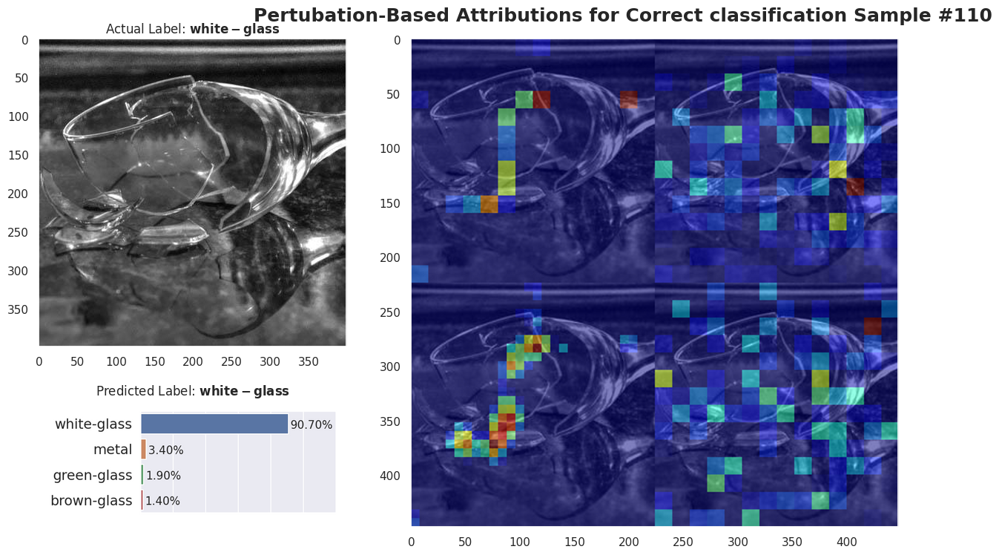

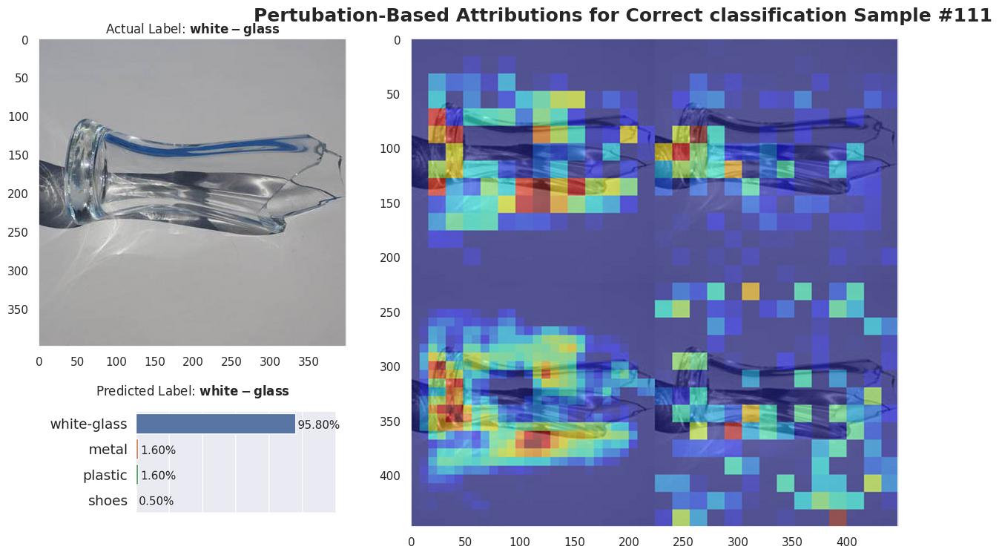

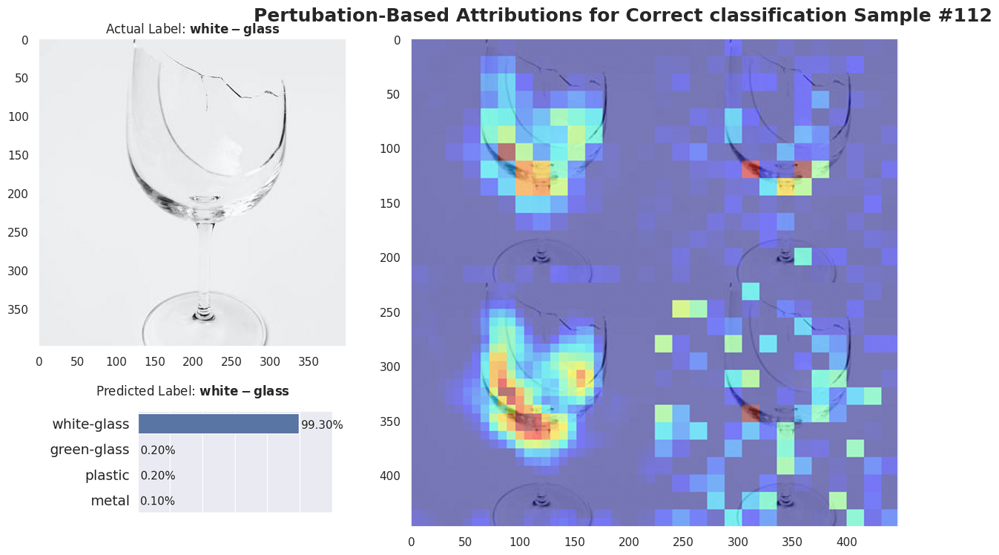

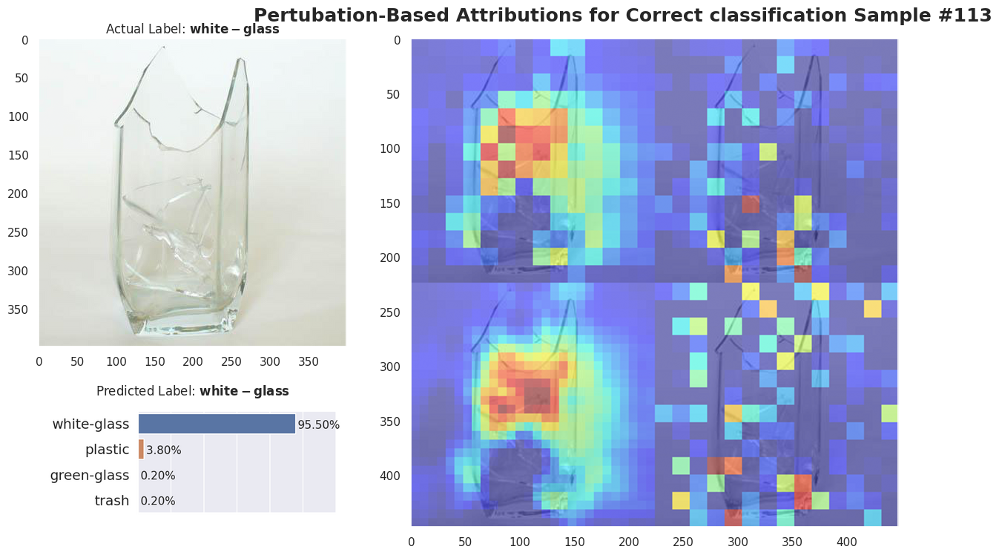

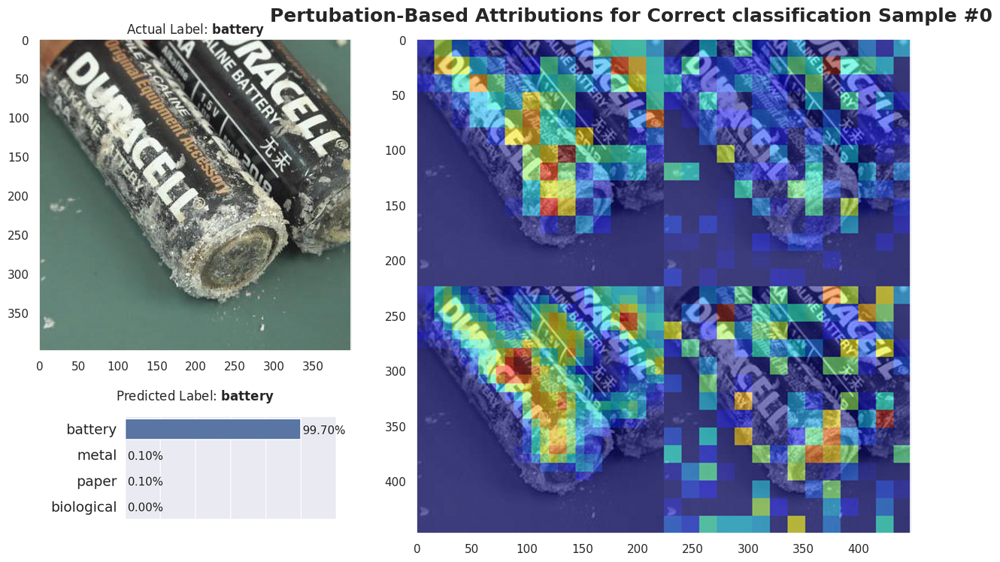

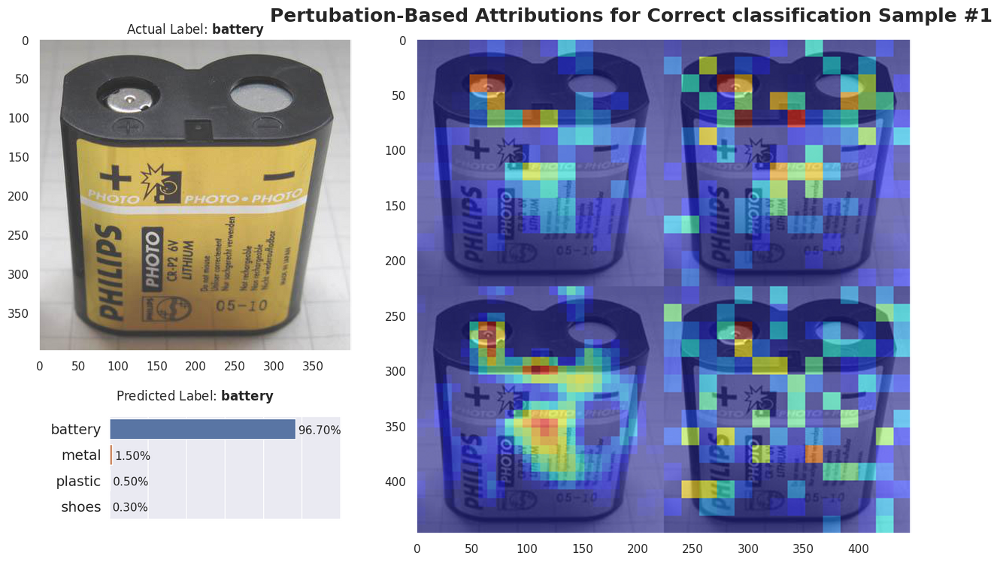

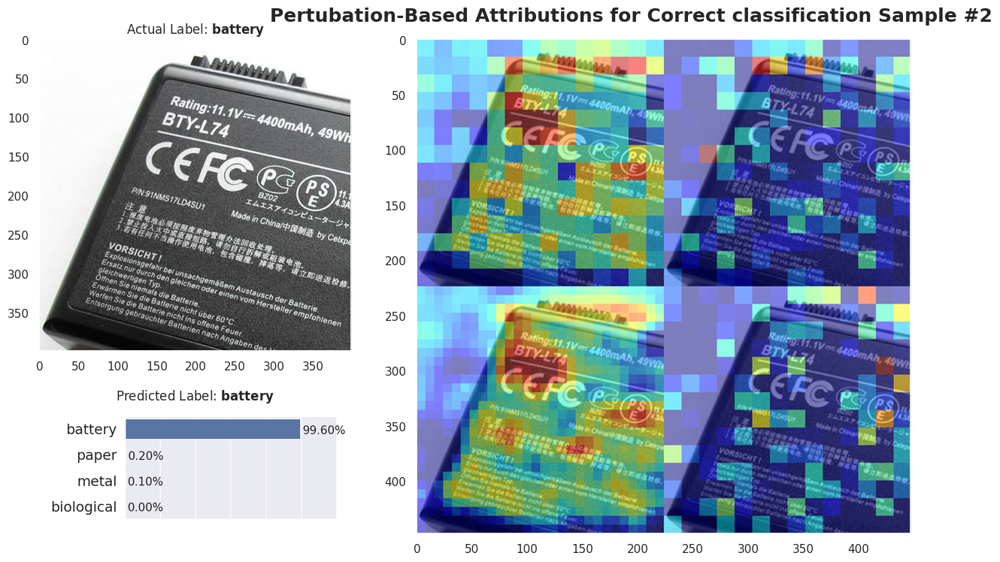

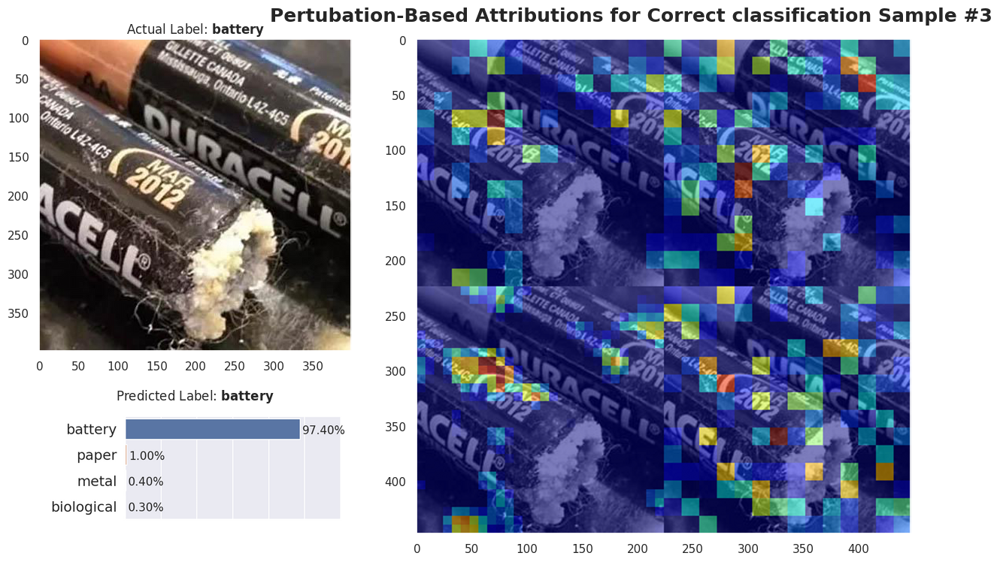

In [ ]:
for pos, idx in enumerate(correctcls_idxs):
    orig_img = mldatasets.tensor_to_img(test_400_data[idx][0],\
                                        norm_std, norm_mean, to_numpy=True)
    bg_img = mldatasets.tensor_to_img(test_data[idx][0],\
                                      norm_std, norm_mean, to_numpy=True)
    map1 = mldatasets.tensor_to_img(ablation_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map2 = mldatasets.tensor_to_img(svs_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map3 = mldatasets.tensor_to_img(occlusion_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    map4 = mldatasets.tensor_to_img(kshap_light_maps[pos], to_numpy=True,\
                                    cmap_norm='positive', overlay_bg=bg_img)
    viz_img = cv2.vconcat([
            cv2.hconcat([map1, map2]),
            cv2.hconcat([map3, map4])
        ])
    label = int(y_test[idx])
    y_true = labels_l[label]
    y_pred = y_test_pred[idx]
    probs_s = probs_df.loc[idx]
    title = 'Pertubation-Based Attributions for Correct classification Sample #{}'.format(idx)
    mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                    y_pred, probs_s, title=title)